# Analysis

Template for Jupyter notebooks running Python.

Version 0.1.0 \| First Created July 12, 2023 \| Updated August 01, 2023

## Jupyter Notebook

This is an Jupyter Notebook document. For more details on using a Jupyter Notebook see <https://docs.jupyter.org/en/latest/>.



# Reproduction of Urban Environmental Justice of Green Space Access in Chicago

### Authors

- Isaiah Bennett\*, ibennett@middlebury.edu, @isaiahbennett2, ORCID link, Middlebury
- Tate Sutter, tsutter@middlebury.edu, @githubname, ORCID link, affiliated institution(s)

\* Corresponding author and creator



### Abstract

This study is a *reproduction* of:

The lab called "Urban Environmental Justice of Green Space Access in Chicago" from Middlebury College's Human Geography with GIS class. 

The abstract of the original study is as follows: 

Green space provide numerous public health, social, and environmental benefits to cities and their residents. These include
mitigation of urban heat, improved storm water management and water quality, improved air quality, expanded access to
exercise, and the social-psychological benefits of enjoying nature.

In this lab, we will conduct a GIS study similar to Wolch, Wilson and Fehrenbach's (2005) research on access to green
spaces in Los Angeles, California. Wolch et al's purpose was to assess the environmental justice implications of municipal
green spaces and recreation funding policies (Proposition K), asking whether minority groups, and especially minority
children, were disproportionately excluded from access to green spaces. They operationalized the concept of "access" in
terms of both the proximity and the total area of green spaces, and found significant disparities between racial/ethnic
groups, rooted in histories of bias and segregation.

Our purpose is to assess people's access to green space (parks and forests) in segregated neighborhoods of Chicago. To do
so, we will estimate indicators of access to green space according to regions where Asian, Black, Latinx, or White
ethnic/racial groups are the majority (60% of the population or more), and Mixed neighborhoods where no single group
makes up 60% or more of the population. The indicators of green space access are:

• Percentage of people living within 0.25 miles of a green space

• Green space area per person (in square meters)




A graphical abstract of the study could also be included as an image here.



### Study metadata

- `Key words`: Comma-separated list of keywords (tags) for searchability. Geographers often use one or two keywords each for: theory, geographic context, and methods.
- `Subject`: select from the [BePress Taxonomy](http://digitalcommons.bepress.com/cgi/viewcontent.cgi?article=1008&context=reference)
- `Date created`: date when project was started
- `Date modified`: date of most recent revision
- `Spatial Coverage`: The city of Chicago, Illinois
- `Spatial Resolution`: Tracts
- `Spatial Reference System`: EPSG 6454
- `Temporal Coverage`: Specify the temporal extent of your study---i.e. the range of time represented by the data observations.
- `Temporal Resolution`: Specify the temporal resolution of your study---i.e. the duration of time for which each observation represents or the revisit period for repeated observations
- `Funding Name`: name of funding for the project
- `Funding Title`: title of project grant
- `Award info URI`: web address for award information
- `Award number`: award number

#### Original study spatio-temporal metadata

- `Spatial Coverage`: extent of original study
- `Spatial Resolution`: resolution of original study
- `Spatial Reference System`: spatial reference system of original study
- `Temporal Coverage`: temporal extent of original study
- `Temporal Resolution`: temporal resolution of original study



## Study design

This study is a reproduction study of an unpublished geography study that was made for Middlebury College's Human Geography with GIS class to be done in QGIS. I completed the study last spring when I was in the course Human Geography with GIS, but wanted to revisit it through a computational environment to contribute to the world of reproducible science. Since this is not a computationally intensive study, its purpose is to act as a simple example to show new GIScientists what the world of reproduction lools like by demonstrating easily digestible components of reproducible research such as making a preanalysis plan (preregistration plan), setting up a reproducible computational environment, sharing data and metadata, sharing methods and code, working through a reproduction study notebook, and exploring a research compendium. 




Enumerate specific **hypotheses** to be tested or **research questions** to be investigated here, and specify the type of method, statistical test or model to be used on the hypothesis or question.

## Materials and procedure

## Computational environment

Maintaining a reproducible computational environment requires some conscious choices in package management.

Please refer to `00-Python-environment-setup.ipynb` for details.



In [2]:
# report python version and install required packages
# switch if statement from True to False once packages have been installed
if True:
    !python -V
    !pip install -r ../environment/requirements.txt

Python 3.11.5


In [393]:
# Import modules, define directories
from pyhere import here
import numpy as np
import pandas as pd
import geopandas as gpd
import folium as fm
from scipy.stats import spearmanr
from branca.colormap import LinearColormap
import matplotlib.pyplot as plt
from matplotlib.patches import Patch

# You can define your own shortcuts for file paths:
path = {
    "dscr": here("data", "scratch"),
    "drpub": here("data", "raw", "public"),
    "drpriv": here("data", "raw", "private"),
    "ddpub": here("data", "derived", "public"),
    "ddpriv": here("data", "derived", "private"),
    "rfig": here("results", "figures"),
    "roth": here("results", "other"),
    "rtab": here("results", "tables"),
    "dmet": here("data", "metadata")
}

### Data and variables

#### Tracts2010

**Standard Metadata**

- `Title`: Tracts2010.shp
- `Abstract`: census tracts from the 2010 Census for Chicago containing with demographic data joined from the P2 
- `Spatial Coverage`: The city of Chicago, Illinois
- `Spatial Resolution`: Tracts
- `Spatial Reference System`: EPSG 6454
- `Temporal Coverage`: 
- `Temporal Resolution`: 2010
- `Lineage`: Data was downloaded from Middlebury College Geog 120 Week 04 Lab: Urban Models of Segregation by Race and Class which collected the data from Steven Manson, Jonathan Schroeder, David Van Riper, and Steven Ruggles. IPUMS National Historical
Geographic Information System: Version 13.0 [Database]. Minneapolis: University of Minnesota. 2018. http://doi.org/10.18128/D050.V13.0.
- `Distribution`: Data is available 
- `Constraints`: No legal constraints
- `Data Quality`: No planned quality assessment

| Label | Alias | Definition | Type | Accuracy | Domain | Missing Data Value(s) | Missing Data Frequency |
| :--: | :--: | :--: | :--: | :--: | :--: | :--: | :--: |
| fid| :--: | object id | int
| STATEFP10| :--: | state id | int
| COUNTYFP10| :--: | county id | int
| TRACTCE10| :--: | tract id | int
| GEOID10| :--: | geography id | int
| NAME10| :--: | ? |  int
| NAMELSAD10| :--: | census tract name | string 
| GISJOIN| :--: | uniquely identifies tracts for purpose of joining to geographic data | string
| PopTotal| :--: | total population |  int
| Latinx| :--: | total Hispanic or Latino/Latina population | int
| NotLatinx| :--: | total non-Hispanic White population | int
| White| :--: | total non-Hispanic White population | int
| Black| :--: | total non-Hispanic Black or African American population | int
| Asian| :--: | total non-Hispanic Asian population | int
| TwoOrMore| :--: | ? | int
| MedHouseVa| :--: | median house value for owner-occupied houses | int
| MedGrossRe| :--: | median gross monthly rent (including utilities) | int
| pctWhite| :--: | percent white population | double
| pctBlack| :--: | percent black population | double
| pctLatinx| :--: | percent latinx population | double
| pctAsian| :--: | percent asian population | double

In [396]:
#load in tracts 2010
tracts2010 = gpd.read_file( here(path["drpub"], "tracts2010.shp") )
tracts2010 = gpd.GeoDataFrame(tracts2010)

# Create folium map
mtracts = fm.Map([41.88155337370558, -87.63007007169067], zoom_start=10, tiles = "CartoDB Positron")

# Define a style dictionary to adjust line properties (e.g., line weight)
style_function = lambda x: {'color': 'blue', 'weight': 1, 'lineweight': '.40', 'fillColor': 'blue', 'fillOpacity': '.40'}

# Add the GeoJson layer to the map
fm.GeoJson(tracts2010, style_function=style_function).add_to(mtracts)

mtracts
#print(tracts2010)

#### Blocks2010

**Standard Metadata**

- `Title`: Blocks2010.shp
- `Abstract`: census blocks from the 2010 Census for Chicago containing with demographic data joined from the P2
- `Spatial Coverage`: The city of Chicago, Illinois
- `Spatial Resolution`: Block groups
- `Spatial Reference System`: EPSG 6454
- `Temporal Coverage`: Specify the temporal extent of your study---i.e. the range of time represented by the data observations.
- `Temporal Resolution`: 2010
- `Lineage`: Data was downloaded from Middlebury College Geog 120 Week 07 Lab which collected the data from Steven Manson, Jonathan Schroeder, David Van Riper, and Steven Ruggles. IPUMS National Historical
Geographic Information System: Version 13.0 [Database]. Minneapolis: University of Minnesota. 2018. http://doi.org/10.18128/D050.V13.0.
- `Distribution`: Data is available 
- `Constraints`: No legal constraints
- `Data Quality`: No planned quality assessment

| Label | Alias | Definition | Type | Accuracy | Domain | Missing Data Value(s) | Missing Data Frequency |
| :--: | :--: | :--: | :--: | :--: | :--: | :--: | :--: |
| GEO.id | ... | Id | string | ... | ... | ... | ... |
| GEO.id2 | ... | Id2 | string | ... | ... | ... | ... | 
| GEO.display-label | ... | Geography | geometry | ... | ... | ... | ... |
| D001 | ... | Total Population | int | ... | ... | ... | ... |
| D002 | ... | Hispanic or Latino | int | ... | ... | ... | ... |
| D003 | ... | Not Hispanic or Latino | int | ... | ... | ... | ... |
| D004 | ... | Not Hispanic or Latino: - Population of one race | int | ... | ... | ... | ... |
| D005 | ... | Not Hispanic or Latino: - White alone | int | ... | ... | ... | ... |
| D006 | ... | Not Hispanic or Latino: - Black or African American alone | int | ... | ... | ... | ... |
| D007 | ... | Not Hispanic or Latino: - American Indian and Alaska Native alone | int | ... | ... | ... | ... |
| D008 | ... | Not Hispanic or Latino: - Asian alone | int | ... | ... | ... | ... |
| D009 | ... | Not Hispanic or Latino: - Native Hawaiian and Other Pacific Islander alone | int | ... | ... | ... | ... |
| D010 | ... | Not Hispanic or Latino: - Some Other Race alone | int | ... | ... | ... | ... |


In [394]:
# Load in blocks 2010
blocks2010 = gpd.read_file( here(path["drpub"], "blocks2010.shp") )
blocks2010 = gpd.GeoDataFrame(blocks2010)

#### Parks

**Standard Metadata**

- `Title`: parks.shp
- `Abstract`: parks in Chicago
- `Spatial Coverage`: The city of Chicago, Illinois
- `Spatial Resolution`: park polygons 
- `Spatial Reference System`: EPSG 6454
- `Temporal Coverage`: Specify the temporal extent of your study---i.e. the range of time represented by the data observations.
- `Temporal Resolution`: 2010
- `Lineage`: Data was downloaded from Middlebury College Geog 120 Week 07 Lab Urban Environmental Justice of Green Space Access in Chicago
- `Distribution`: Data is available 
- `Constraints`: No legal constraints
- `Data Quality`: No planned quality assessment

| Label | Alias | Definition | Type | Accuracy | Domain | Missing Data Value(s) | Missing Data Frequency |
| :--: | :--: | :--: | :--: | :--: | :--: | :--: | :--: |
| parkName | :--: | names of every park in Chicago | string |


In [397]:
# Load in parks
parks = gpd.read_file( here(path["drpub"], "parks.shp") )
parks = gpd.GeoDataFrame(parks)

# Define a style dictionary to adjust symbology
style_function = lambda x: {'color': 'green', 'weight': 1, 'fillColor': 'green', 'fillOpacity': '100'}

fm.GeoJson(parks, style_function=style_function).add_to(mtracts)

# Display map
mtracts

#### Forest
​
**Standard Metadata**
​
- `Title`: forest.shp
- `Abstract`: forest areas in Chicago
- `Spatial Coverage`: The city of Chicago, Illinois
- `Spatial Resolution`: forest polygons
- `Spatial Reference System`: EPSG 6454
- `Temporal Coverage`: Specify the temporal extent of your study---i.e. the range of time represented by the data observations.
- `Temporal Resolution`: 2010
- `Lineage`: Data was downloaded from Middlebury College Geog 120 Week 07 Lab Urban Environmental Justice of Green Space Access in Chicago
- `Distribution`: Data is available 
- `Constraints`: No legal constraints
- `Data Quality`: No planned quality assessment 

| Label | Alias | Definition | Type | Accuracy | Domain | Missing Data Value(s) | Missing Data Frequency |
| :--: | :--: | :--: | :--: | :--: | :--: | :--: | :--: |
|  NAME | :--: | single multi part polygon with all forest areas | string | 

In [399]:
# Load in forest
forest = gpd.read_file( here(path["drpub"], "forest.shp") )
forest = gpd.GeoDataFrame(forest)

# Define a style dictionary to adjust line properties 
style_function = lambda x: {'color': 'darkgreen', 'weight': 1, 'fillColor': 'darkgreen', 'fillOpacity': '100'}

fm.GeoJson(forest, style_function=style_function).add_to(mtracts)

# Display map
mtracts

### Bias and threats to validity

**Boundary Effects:** Restricted to the extent of the city of Chicago the hard boundary of the city’s border could cut off people along the edges who might access a park within 0.25 miles outside of the city making it seem like they have less access to green space than people within the city.

**Modifiable Aerial Unit Problem:** The population with access to green space is calculated based on block groups which is one of the smallest enumeration units.  This decreases the chances that diversity in spatial trends is generalized. The racial majority groups are calculated at the tract level, however, which might ignore varying trends between racial majority groups at the block group level.

**Spatial Heterogeneity:** This poses an issue when looking at the differences in greenspaces. Not all greenspaces have the same amenities or quality for their communities to access–just because it technically counts as a greenspace does not mean it has the same inherent value as other greenspaces. The size of the greenspace presents a parallel problem. Since access to greenspace is determined by a constant buffer of 0.25 miles it does not account for the fact that smaller spaces can reach more people proportionally to the size of the green space. Perhaps smaller green spaces should have a smaller buffer since they do not have a proportional capacity of use when compared to larger parks with the same 0.25-mile buffer.



### Data transformations

The first data transformation is joining the parks and forests shapefiles since they come from different sources but together represent the total green space of Chicago. 


In [334]:
# Join parks and forest
greenspace = gpd.overlay(parks, forest, how='union')

The construction of a new variable, the majority group column, in the tract data frame must also be calculated to continue with the analysis. The majority group is calculated by a threshold of 60% population, so if a tract has a single-race population percentage over 60% then it is given the designation of that race. Only White, Black, Asian, and Latinx are considered in this study as they were the most dominant in Chicago in 2010. The 60% threshold is a seemingly arbitrary choice in the original study design and could be modified to see how it influences the final results. 

In [ ]:
# Calculate Majority Group in tracts
threshold = 60.0
for index, row in tracts2010.iterrows():
    # Check the condition for each row using 'index' to access specific values
    if row['pctWhite'] >= threshold:  # Check if 'pctWhite' is greater than or equal to 60.0
        tracts2010.loc[index, 'majorGroup'] = 'White'  # Assign 'White' to 'majorGroup'
    elif row['pctBlack'] >= threshold:  
        tracts2010.loc[index, 'majorGroup'] = 'Black'
    elif row['pctAsian'] >= threshold:  
        tracts2010.loc[index, 'majorGroup'] = 'Asian'
    elif row['pctLatinx'] >= threshold:  
        tracts2010.loc[index, 'majorGroup'] = 'Latinx'
    else: 
        tracts2010.loc[index, 'majorGroup'] = 'Mixed'
print(tracts2010)

### Analysis

Describe the methods of analysis that will directly test the hypotheses or provide results to answer the research questions.
This section should explicitly define any spatial / statistical *models* and their *parameters*, including *grouping* criteria, *weighting* criteria, and *significance thresholds*.
Also explain any follow-up analyses or validations.



#### Buffer green space

In [ ]:
# Buffer by 0.25 miles converted to meters (1 mile ≈ 1609.34 meters)
bufferdist= 0.25 #in miles

greenspacebuffer = greenspace.buffer(bufferdist * 1609.34)

# Convert from multiple polygons into a single multi-part polygon
greenspacebuffer_single = greenspacebuffer.unary_union

# Turn buffered green space into geodataframe
bufferedgreen = gpd.GeoDataFrame(geometry=[greenspacebuffer_single], crs=blocks2010.crs)

# Create folium map
m = fm.Map([41.88155337370558, -87.63007007169067], zoom_start=10, tiles = "CartoDB Positron")

# Define a style dictionary to adjust symbology
style_function = lambda x: {'color': '#bbde93', 'weight': 1, 'fillColor': '#bbde93', 'fillOpacity': '100'}

# Add the GeoJson layer to the map
fm.GeoJson(greenspacebuffer, style_function=style_function).add_to(m)

m

#### Calculate blocks with accessibility

In [338]:
#create centroids
centroids = blocks2010.geometry.centroid #check to see how this happens 

#turn into geodataframe
blockscentroids = gpd.GeoDataFrame(geometry=centroids, crs=blocks2010.crs)

# Select centroids that intersect with buffered greenspaces
greenaccessblocks = gpd.sjoin(blockscentroids, bufferedgreen, how="inner", predicate="intersects")

# Merge the original block data with the selected blocks based on centroid intersections
greenaccessblocks = greenaccessblocks.merge(blocks2010, left_index=True, right_index=True)


print(greenaccessblocks)

                          geometry_x  index_right STATEFP10 COUNTYFP10  \
0      POINT (342386.609 592746.434)            0        17        031   
1      POINT (349907.619 569972.596)            0        17        031   
6      POINT (353790.443 559307.660)            0        17        031   
8      POINT (352103.424 565989.735)            0        17        031   
9      POINT (351961.067 566588.261)            0        17        031   
...                              ...          ...       ...        ...   
46015  POINT (358311.033 581254.433)            0        17        031   
46016  POINT (358752.163 580922.655)            0        17        031   
46017  POINT (358851.442 580365.844)            0        17        031   
46018  POINT (359152.428 579509.424)            0        17        031   
46019  POINT (359689.011 579678.611)            0        17        031   

      TRACTCE10 BLOCKCE10          GEOID10      NAME10 MTFCC10 UR10  ... D002  \
0        090200      4033  170

#### Join to Tracts2010 by tract id

In [341]:
#Group by Tract id 
greenaccessPop = greenaccessblocks.groupby('TRACTCE10')['D001'].sum().reset_index()

# join by tractce10 and add totalpopaccess 
greenaccesstracts = tracts2010.merge(greenaccessPop[['TRACTCE10', 'D001']], on='TRACTCE10', how='left')

# create a Geodataframe with the greenaccesstracts
greenaccesstracts = gpd.GeoDataFrame(greenaccesstracts)
print(greenaccesstracts)

       fid STATEFP10 COUNTYFP10 TRACTCE10      GEOID10   NAME10  \
0      1.0        17        031    650302  17031650302  6503.02   
1      2.0        17        031    561000  17031561000     5610   
2      3.0        17        031    530502  17031530502  5305.02   
3      4.0        17        031    160300  17031160300     1603   
4      5.0        17        031    081600  17031081600      816   
..     ...       ...        ...       ...          ...      ...   
782  783.0        17        031    222700  17031222700     2227   
783  784.0        17        031    491100  17031491100     4911   
784  785.0        17        031    510100  17031510100     5101   
785  786.0        17        031    570100  17031570100     5701   
786  787.0        17        031    640300  17031640300     6403   

               NAMELSAD10         GISJOIN  PopTotal  Latinx  ...  TwoOrMore  \
0    Census Tract 6503.02  G1700310650302    4344.0  3708.0  ...        NaN   
1       Census Tract 5610  G170031056

#### Final calculations by majority group

In [343]:
#group by majority group
groupedgreenaccess = greenaccesstracts.dissolve(by='majorGroup', aggfunc={
         "majorGroup": "count","PopTotal":'sum',"D001":'sum'})
groupedgreenaccess = groupedgreenaccess.rename(columns={'majorGroup': 'Tracts'})

groupedgreenaccess

,geometry,Tracts,PopTotal,D001
majorGroup,,,,
Asian,"POLYGON ((358407.725 574382.741, 358401.906 57...",4,13875.0,11248.0
Black,"MULTIPOLYGON (((348871.269 570899.656, 348859....",269,755569.0,483672.0
Latinx,"MULTIPOLYGON (((350870.400 563932.375, 350872....",146,579637.0,334119.0
Mixed,"MULTIPOLYGON (((350889.211 563322.280, 350891....",178,669499.0,512778.0
White,"MULTIPOLYGON (((345676.237 567144.059, 345642....",190,660728.0,487125.0


In [344]:
#calculate area for each majority group
groupedgreenaccess['area_sqm'] = groupedgreenaccess.geometry.area

groupedgreenaccess

,geometry,Tracts,PopTotal,D001,area_sqm
majorGroup,,,,,
Asian,"POLYGON ((358407.725 574382.741, 358401.906 57...",4,13875.0,11248.0,1.983068e+06
Black,"MULTIPOLYGON (((348871.269 570899.656, 348859....",269,755569.0,483672.0,1.964818e+08
Latinx,"MULTIPOLYGON (((350870.400 563932.375, 350872....",146,579637.0,334119.0,9.621542e+07
Mixed,"MULTIPOLYGON (((350889.211 563322.280, 350891....",178,669499.0,512778.0,1.453426e+08
White,"MULTIPOLYGON (((345676.237 567144.059, 345642....",190,660728.0,487125.0,1.186064e+08


In [346]:
#clip grouped green access and green space 
majorGrnSpace = groupedgreenaccess.clip(greenspace) 

# Calculate green space area
majorGrnSpace['areaGrn_sqm'] = majorGrnSpace.geometry.area

# Calculate 'pctAccess' as a percentage of access per population
majorGrnSpace['pctAccess'] = (majorGrnSpace['D001'] / majorGrnSpace['PopTotal']) * 100

# Calculate 'pctAreaPop' as the ratio of green area to population
majorGrnSpace['pctAreaPop'] = majorGrnSpace['areaGrn_sqm'] / majorGrnSpace['PopTotal']

majorGrnSpace

,geometry,Tracts,PopTotal,D001,area_sqm,areaGrn_sqm,pctAccess,pctAreaPop
majorGroup,,,,,,,,
Black,"MULTIPOLYGON (((355481.444 561993.089, 355458....",269,755569.0,483672.0,1.964818e+08,1.349878e+07,64.014273,17.865712
Latinx,"MULTIPOLYGON (((357408.653 576717.364, 357418....",146,579637.0,334119.0,9.621542e+07,2.667939e+06,57.642801,4.602775
Mixed,"MULTIPOLYGON (((352328.568 566122.129, 352338....",178,669499.0,512778.0,1.453426e+08,8.965317e+06,76.591302,13.391083
White,"MULTIPOLYGON (((347461.379 568394.469, 347367....",190,660728.0,487125.0,1.186064e+08,1.151111e+07,73.725497,17.421861
Asian,"MULTIPOLYGON (((358470.236 575562.435, 358470....",4,13875.0,11248.0,1.983068e+06,2.768250e+04,81.066667,1.995135


## Results

Describe how results are to be presented.



In [373]:
# Rename index column 
majorGrnSpace = majorGrnSpace.rename_axis('Majority Group')

#Clean up names and round 
table1 = majorGrnSpace
table1['Population'] = table1['PopTotal'].round(0).astype(int) 
table1['Population with Access'] = table1['D001'].round(0).astype(int) 
table1['Area (sqm)'] = table1['area_sqm'].round(0).astype(int) 
table1['Green Space Area (sqm)'] = table1['areaGrn_sqm'].round(0).astype(int)
table1['Percent Population with Access'] = table1['pctAccess'].round(1)
table1['Green Space Per Person (sqm)'] = table1['pctAreaPop'].round(1)
table1 = table1.drop(columns = ["geometry", "PopTotal", "D001", "area_sqm", "areaGrn_sqm", "pctAccess", "pctAreaPop"])
 
table1.to_csv( here(path["rtab"],"table1.csv") )# Save image

table1

,Tracts,Population,Population with Access,Area (sqm),Green Space Area (sqm),Percent Population with Access,Green Space Per Person (sqm)
Majority Group,,,,,,,
Black,269,755569,483672,196481794,13498778,64.0,17.9
Latinx,146,579637,334119,96215420,2667939,57.6,4.6
Mixed,178,669499,512778,145342623,8965317,76.6,13.4
White,190,660728,487125,118606374,11511111,73.7,17.4
Asian,4,13875,11248,1983068,27683,81.1,2.0


In [370]:
# load and compare original results 
original_results = gpd.read_file( here(path["ddpub"], "original_results.csv") ) 
original_results = pd.DataFrame(original_results)
#original_results = original_results.set_index(original_results.columns[1])

#original_results['Population with Access'] = original_results['Population with Access'].astype(int)
original_results = original_results.drop(columns = ['geometry'])

original_results

,Majority Group,Tracts,Population,Population with Access,Area (sqm),Green Space Area (sqm),Percent Population with Access,Green Space Per Person (sqm)
0,Black,269,"755,569","482,153","196,481,794","13,498,778",63.8,17.9
1,Latinx,146,"579,637","332,655","96,215,420","2,667,939",57.4,4.6
2,Mixed,178,"669,499","510,794","145,342,623","8,965,317",76.3,13.4
3,White,190,"660,728","485,254","118,606,374","11,511,111",73.4,17.4
4,Asian,4,"13,875","10,876","1,983,068","27,683",78.4,2.0


In [354]:
column_name = 'Green Space Per Person (sqm)'

# Calculate Spearman's rank correlation coefficient
spearman_corr, p_value = spearmanr(table1[column_name], original_results[column_name])

print(f"Spearman's rank correlation coefficient:", column_name, spearman_corr)
print(f"P-value: {p_value}")

Spearman's rank correlation coefficient: Green Space Per Person (sqm) -0.49999999999999994
P-value: 0.39100221895577053


#### Visualize racial majority group and greenspace map

In [389]:
# create a Geodataframe with the greenaccesstracts
greenaccesstracts = gpd.GeoDataFrame(tracts2010)


# Create folium map
mrace = fm.Map([41.88155337370558, -87.63007007169067], zoom_start=10, tiles = "CartoDB Positron")

def style_function(feature):
    major_group = feature['properties']['majorGroup']
    if major_group == 'Asian':
        color = '#bf8282FF'
    elif major_group == 'Black':
        color = '#bbafd0FF'
    elif major_group == 'Latinx':
        color = '#e4b586FF'
    elif major_group == 'Mixed':
        color = '#feffa6FF'
    elif major_group == 'White':
        color = '#4468a8FF'
    else:
        color = '#ffff00'  # Default color if 'majorGroup' doesn't match any condition

    return {
        'fillColor': color,
        'color': 'grey',
        'weight': 0.3,
        'dashArray': '5, 5',
        'fillOpacity': '100'
    }
green_style = lambda x: {'color': '#bbde93', 'weight': 1, 'fillColor': '#bbde93', 'fillOpacity': '100'}

# Add the GeoJson layer to the map
fm.GeoJson(greenaccesstracts, style_function=style_function).add_to(mrace)
fm.GeoJson(greenspace, style_function=green_style).add_to(mrace)

mrace

In [390]:
greenaccesstracts = greenaccesstracts.dissolve(by= 'majorGroup')
greenaccesstracts['majorityGroup'] = greenaccesstracts.index


,geometry,fid,STATEFP10,COUNTYFP10,TRACTCE10,GEOID10,NAME10,NAMELSAD10,GISJOIN,PopTotal,...,White,Black,Asian,TwoOrMore,MedHouseVa,MedGrossRe,pctWhite,pctBlack,pctLatinx,pctAsian
majorGroup,,,,,,,,,,,,,,,,,,,,,
Asian,"POLYGON ((358407.725 574382.741, 358401.906 57...",146.0,17,031,841100,17031841100,8411,Census Tract 8411,G1700310841100,7254.0,...,334.0,258.0,6438.0,NaN,241400.0,644.0,4.6,3.6,1.9,88.8
Black,"MULTIPOLYGON (((348871.269 570899.656, 348859....",3.0,17,031,530502,17031530502,5305.02,Census Tract 5305.02,G1700310530502,1667.0,...,0.0,1624.0,0.0,105.0,147700.0,1315.0,0.0,97.4,0.0,0.0
Latinx,"MULTIPOLYGON (((350870.400 563932.375, 350872....",1.0,17,031,650302,17031650302,6503.02,Census Tract 6503.02,G1700310650302,4344.0,...,482.0,127.0,0.0,118.0,217000.0,982.0,11.1,2.9,85.4,0.0
Mixed,"MULTIPOLYGON (((350889.211 563322.280, 350891....",4.0,17,031,160300,17031160300,1603,Census Tract 1603,G1700310160300,3785.0,...,2181.0,300.0,363.0,120.0,192100.0,787.0,57.6,7.9,21.5,9.6
White,"MULTIPOLYGON (((345676.237 567144.059, 345642....",2.0,17,031,561000,17031561000,5610,Census Tract 5610,G1700310561000,5161.0,...,3794.0,0.0,0.0,132.0,256300.0,717.0,73.5,0.0,24.7,0.0


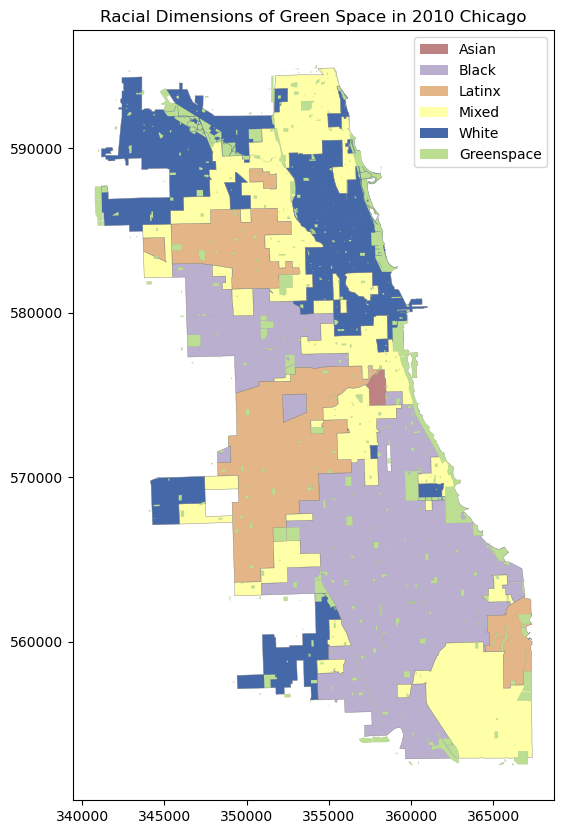

<Figure size 640x480 with 0 Axes>

In [392]:
import geopandas as gpd
import matplotlib.pyplot as plt
from matplotlib.patches import Patch

greenaccesstracts = greenaccesstracts.dissolve(by= 'majorGroup')
greenaccesstracts['majorityGroup'] = greenaccesstracts.index

# Set up the base plot
fig, ax = plt.subplots(figsize=(10, 10))

# Define a function to assign colors based on 'majorGroup' column
def assign_color(feature):
    major_group = feature['majorityGroup']
    if major_group == 'Asian':
        return '#bf8282FF'
    elif major_group == 'Black':
        return '#bbafd0FF'
    elif major_group == 'Latinx':
        return '#e4b586FF'
    elif major_group == 'Mixed':
        return '#feffa6FF'
    elif major_group == 'White':
        return '#4468a8FF'
    else:
        return '#ffff00'

# Plot greenaccesstracts with different colors based on 'majorGroup' column
greenaccesstracts.plot(ax=ax, color=greenaccesstracts.apply(assign_color, axis=1), edgecolor='grey', linewidth=0.3)

# Plot greenspace in a specific color and style
greenspace.plot(ax=ax, color='#bbde93', edgecolor='grey', linewidth=0.05, alpha=1)

# Customize the plot (add title, legend, etc.) as needed
plt.title('Racial Dimensions of Green Space in 2010 Chicago')
legend_patches = [
    Patch(facecolor='#bf8282FF', label='Asian'),
    Patch(facecolor='#bbafd0FF', label='Black'),
    Patch(facecolor='#e4b586FF', label='Latinx'),
    Patch(facecolor='#feffa6FF', label='Mixed'),
    Patch(facecolor='#4468a8FF', label='White'),
    Patch(facecolor='#bbde93', label='Greenspace')
]

# Add legend with the created patches
plt.legend(handles=legend_patches)

# Show the plot
plt.show()

plt.savefig( here(path["rfig"], 'fig1.png') ) # Save image

## Discussion

Describe how the results are to be interpreted *vis a vis* each hypothesis or research question.



## Integrity Statement

Include an integrity statement - The authors of this preregistration state that they completed this preregistration to the best of their knowledge and that no other preregistration exists pertaining to the same hypotheses and research.
If a prior registration *does* exist, explain the rationale for revising the registration here.



# Acknowledgements

- `Funding Name`: name of funding for the project
- `Funding Title`: title of project grant
- `Award info URI`: web address for award information
- `Award number`: award number

This report is based upon the template for Reproducible and Replicable Research in Human-Environment and Geographical Sciences, DOI:[10.17605/OSF.IO/W29MQ](https://doi.org/10.17605/OSF.IO/W29MQ)

## References